In [126]:
# Colour histogram feature: 
# • Consider 32 x 32 nonoverlapping patches on every images (from training and test sets). 
# For  example,  if  image  size  is  256  x  256,  there  will  be  32  number  of  32  x  32  
# nonoverlapping patches.  
# • Extract 8-bin colour histogram from every colour channel (R, G and B) from a patch. It 
# results  in  3,  8-dimentional  feature  vectors.  Concatenate  them  to  form  24-dimentional 
# feature vector.  
# • Similarly extract 24-dimentional feature vector from every patch.  
# • Stack the 24-dimentional feature vectors corresponding to every patch in an image and 
# save them as a file in the corresponding class folder.  
# • Thus,  an  image  is  represented  as  set  (collection)  of  24-dimentional  colour  histogram  
# vectors representation 
# • Repeat the above steps to all the images in training and test sets of all the classes.   
# Colour histogram is computed as follows from a colour channel: 
# • When the given image is read, it will be read as 3-dimentioanl matrix of pixel values. 
# Each dimension is corresponding to a colour channel. The pixel values in each colour 
# channel are in the range 0 to 255.  
# • For a colour channel,  
# ◦ Divide this range into 8 equal bins.  
# ◦ Count  the  number  of  pixels  falling  into  each  bin.  This  results  in  a  vector  of  8  
# values.  
# ◦ This is the 8-dimentional colour histogram (from a colour channel) feature vector. 
# ◦ Normalise this vector by dividing it by the number of pixels in that image. 
# • Do  the  same  for  other  colour  channels.  Concatenate  those  three  8-dimentional  colour  
# histogram vectors to form 24-dimentional vector.    
# 2. Bag-of-visual-words (BoVW) feature using K-means clustering: 
# • Take  the  24-dimentional  colour  histogram  feature  vectors  of  all  the  training  examples  
# of all the classes.  
# • Group them into 32 clusters using K-means clustering algorithms.  
# • Now  take  an  image,  assign  each  24-dimentional  colour  histogram  feature  vector  to  a  
# cluster.  
# • Count the number of feature vectors assigned to each of the 32 clusters.  
# • This results in a 32-dimentional BoVW representation for that image.  
# • Normalise this vector by dividing it by the number of 24-dimentional histogram feature 
# vectors in that image.  
# • Repeat this for every image in training and test set.  

In [127]:
from PIL import Image

im = Image.open(r".\group16\test\pond\sun_bcyzkxgibrohfkgo.jpg")
# im.show()

In [128]:
px = im.load()
for i in range(im.size[0]):
    print()
    for j in range(im.size[1]):
        print(px[i,j])
        
    


(144, 183, 226)
(144, 183, 226)
(145, 184, 227)
(146, 185, 228)
(146, 185, 228)
(147, 186, 229)
(148, 187, 230)
(148, 187, 230)
(150, 189, 232)
(150, 189, 232)
(151, 190, 233)
(152, 191, 234)
(152, 191, 234)
(153, 192, 235)
(154, 193, 236)
(154, 193, 236)
(154, 193, 234)
(154, 193, 232)
(155, 194, 233)
(156, 195, 234)
(156, 195, 234)
(157, 196, 235)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(158, 197, 236)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(160, 199, 238)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(162, 201, 240)
(164, 203, 242)
(164, 203, 242)
(164, 203, 242)
(164, 203, 242)
(164, 203, 242)
(164, 203, 242)
(164, 2

In [129]:
# getting 32*32 non-overlapping patches

def get_patches(im,p_size=32):
    px = im.load()
    patches = []
    for i in range(0, im.size[0], p_size):
        for j in range(0, im.size[1], p_size):
            patch=[]
            for k in range(i, min(i+ p_size, im.size[0])):
                for l in range(j, min(j+ p_size, im.size[1])):
                    patch.append(px[k, l])
            patches.append(patch)
    return patches

In [130]:
patches = get_patches(im)
print(len(patches))

768


In [131]:
print(patches[0])
# also plot


[(144, 183, 226), (144, 183, 226), (145, 184, 227), (146, 185, 228), (146, 185, 228), (147, 186, 229), (148, 187, 230), (148, 187, 230), (150, 189, 232), (150, 189, 232), (151, 190, 233), (152, 191, 234), (152, 191, 234), (153, 192, 235), (154, 193, 236), (154, 193, 236), (154, 193, 234), (154, 193, 232), (155, 194, 233), (156, 195, 234), (156, 195, 234), (157, 196, 235), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (144, 183, 226), (145, 184, 227), (145, 184, 227), (146, 185, 228), (147, 186, 229), (147, 186, 229), (148, 187, 230), (148, 187, 230), (150, 189, 232), (150, 189, 232), (151, 190, 233), (152, 191, 234), (152, 191, 234), (153, 192, 235), (154, 193, 236), (154, 193, 234), (154, 193, 232), (154, 193, 232), (155, 194, 233), (156, 195, 234), (156, 195, 234), (157, 196, 235), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 236), (158, 197, 23

In [132]:
# getting color histogram
class Feature_Vector:
    def __init__(self):
        self.red = [0]*8
        self.green = [0]*8
        self.blue = [0]*8

def get_color_histogram(patch):
    fv=Feature_Vector()
    for i in patch:
        fv.red[i[0]//32]+=1
        fv.green[i[1]//32]+=1
        fv.blue[i[2]//32]+=1
    return fv        

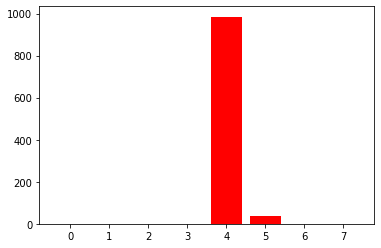

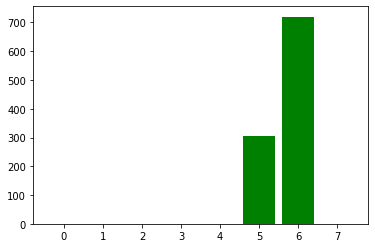

<BarContainer object of 8 artists>

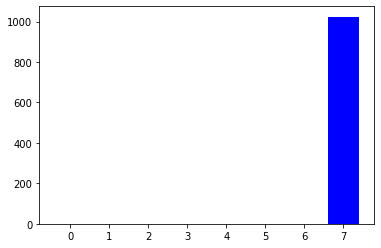

In [133]:
# print the color histogram
fv=get_color_histogram(patches[0])
# plot the color histogram
import matplotlib.pyplot as plt
plt.bar(range(8),fv.red, color='red')
plt.show()
plt.bar(range(8),fv.green, color='green')
plt.show()
plt.bar(range(8),fv.blue, color='blue')
# plot the patch


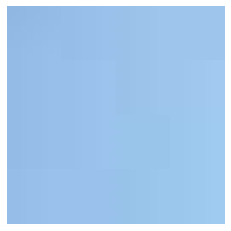

In [134]:
import numpy as np
import matplotlib.pyplot as plt

# RGB data
rgb_data = patches[0]

# Convert RGB data to a NumPy array
rgb_array = np.array(rgb_data, dtype=np.uint8)

# Reshape the data into a 2x2 grid
image = rgb_array.reshape((32, 32, 3))

# Create a figure and plot the image
# plt.figure(figsize=(40, 40))
plt.imshow(image)
plt.axis('off')  # Hide axis labels and ticks
plt.show()

In [135]:
FVS=[]
for patch in patches:
    FVS.append(get_color_histogram(patch))

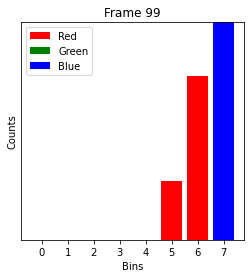

In [136]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML



# Function to update the plot in the animation
def update(frame):
    # Plot the data
    plt.cla()
    plt.bar(range(8),FVS[frame].red, color='red')
    plt.bar(range(8),FVS[frame].green, color='green')
    plt.bar(range(8),FVS[frame].blue, color='blue')
    plt.title('Frame ' + str(frame))
    plt.xlabel('Bins')
    plt.ylabel('Counts')
    plt.ylim(0, 1000)
    plt.xticks(range(8))
    plt.legend(['Red', 'Green', 'Blue'], loc='upper left')
    plt.gca().set_yticks([])
    

# Create a figure
fig = plt.figure(figsize=(4, 4))

# Create the animation
ani = FuncAnimation(fig, update, frames=100, repeat=False)

# Display the animation in the notebook
HTML(ani.to_jshtml())


In [137]:
#reading all the images from the folder forest_needleaf, ice_cream_parlor, pond
import os

# Specify the path to the folder you want to list subfolders from
folder_path = './group16/train/'  # Replace with the actual path

# Use list comprehension to get a list of all subfolders in the folder
subfolders = [f for f in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, f))]


# Print the list of subfolders
for subfolder in subfolders:
    
    #create the folder
    os.mkdir("./Vectors/"+subfolder)
    
    for file in os.listdir(folder_path+subfolder):
        # print(folder_path+subfolder+file)
        im = Image.open(folder_path+subfolder+'/'+file)
        patches = get_patches(im)
        FVS=[]
        for patch in patches:
            FVS.append(get_color_histogram(patch))
        # store each feature vector in a file as numpy array in the corresponding class folder
        np.save("./Vectors/"+subfolder+'/'+file, FVS, allow_pickle=True, fix_imports=True)


In [138]:
# read a vector from a .npy file
FVS = np.load("./Vectors/forest_needleleaf/sun_aalxbocnraukuels.jpg.npy", allow_pickle=True, fix_imports=True)
print(FVS[0].red)
print(FVS[0].green)
print(FVS[0].blue)

[77, 483, 363, 79, 21, 1, 0, 0]
[13, 381, 414, 173, 39, 3, 1, 0]
[477, 410, 105, 30, 1, 1, 0, 0]
